## **Unpaired Image-to-Image Translation Using CycleGAN(Cycle-Consistent Generative Adversarial Networks)**

The implementation is based on **[CycleGAN Paper](https://arxiv.org/pdf/1703.10593.pdf)**

* CycleGAN is a process for training unsupervised image translation models via the Generative Adverserial Network (GAN) architecture using unpaired collections of images from two different domains.
CycleGAN has previously been demonstrated on a range of applications. I used cycleGAN to perform object transfiguration. Transforming images of apple to orange and the reverse, images of orange to apple.

* Dataset : [apple2orange dataset](https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/apple2orange.zip).

**CycleGAN In brief**

It is an extension of the GAN(Generative Adversarial Network) architecture. CycleGAN iincludes the concurrent training of two generators and two discriminators.

One generator takes images of a domain X as input and generate fake images that looks like domain Y and the other generator takes images of domain Y as input and generates fake images that looks like domain X. 

Discriminators are then used to determine the realism of generated fake images and generators then uses the discrminator  to determine what needs to change to fool the discriminator, slightly improving the quality of the generations.Together, the generators and discriminators find an equilibrium during training.

This is sufficient to generate plausible images of each domain, but not sufficient to generate translated versions of the input images from the source domain.

The intution here is, an image generated by the first generator could be used as input to the second generator and the output of the second generator should match the real image and vice versa.

Cycle consistency loss is critical. Cycle consistency comes from the concepts of language translation. It assumes that when we translate from English to Bengali and back from Bengali to English, the original sentence should be obtained. In this project we have used generators, that might be capable of generating plausible images in the target domain. But are not necessarily translations of the input image. That is why, the generators need to be updated with a sense of consistency through its cycles of translations. This notion of cycle consistency allows us to get to the input image using another generator and thus the difference between the real image and the translated image should be as small as possible. Cycle consistency loss compares the input image to the reconstructed image from the CycleGAN and calculates the summed absolute difference of pixel values between the said images using the L1 norm.

The regularization for CycleGAN  is accomplished by cycle consistency, an additional loss to measure the difference between the generated fake image and the real image, and the reverse. Penalizing the generators for not learing the distribution or characteristics of other domain, forcing them to learn the characteristics of new domain and perfrom perfect image translation.

Ususally large dataset of paired examples are needed for training a image to image translation model. Prepaing or getting such datasets can be difficult and expensive. Benefit of CycleGAN is, it can be trained without paired examples. Unpaired image to image translation can be done.

* As per the **[Paper](https://arxiv.org/pdf/1703.10593.pdf)**

![title](https://software.intel.com/sites/default/files/managed/5c/2b/improving-cycle-gan-intel-ai-devcloud-fig5.png)

> "*(a) Our model contains two mapping functions G : X → Y and F : Y → X, and associated adversarial
discriminators DY and DX. DY encourages G to translate X into outputs indistinguishable from domain Y , and vice versa
for DX and F. To further regularize the mappings, we introduce two cycle consistency losses that capture the intuition that if
we translate from one domain to the other and back again we should arrive at where we started: (b) forward cycle-consistency
loss: x → G(x) → F(G(x)) ≈ x, and (c) backward cycle-consistency loss: y → F(y) → G(F(y)) ≈ y*"



In [0]:
!pip install wget

import os
import sys
import wget
import zipfile

import time
import random
import numpy as np
import pandas as pd
import imageio
from PIL import Image
from IPython import display

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
from matplotlib.image import imread

from sklearn.metrics import accuracy_score

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision 
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from tqdm.autonotebook import tqdm
from torchsummary import summary

"""
Ignoring FutureWarning
"""
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=ImportWarning)

  Created wheel for wget: filename=wget-3.2-cp36-none-any.whl size=9682 sha256=8963c21828ff117ce2bda599c626a0c226d77b16e76cb8e01dcb2785513bebb4
  Stored in directory: /root/.cache/pip/wheels/40/15/30/7d8f7cea2902b4db79e3fea550d7d7b85ecb27ef992b618f3f
Successfully built wget


/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [0]:
from google.colab import drive
drive.mount('/content/gdrive/',force_remount=True)

import sys
sys.path.append('/content/gdrive/My Drive/MPDL/')

from mpdl import train_simple_network, Flatten, weight_reset, set_seed

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive/




* As per the **[Paper](https://arxiv.org/pdf/1703.10593.pdf)** I set the parameters.

>"*We use 6 residual blocks for
128 × 128 training images, and **9 residual blocks for 256 ×
256 or higher-resolution training images**. 
Let c7s1-k denote a 7×7 Convolution-InstanceNormReLU layer with k filters and stride 1....
The network with 9 residual blocks consists of:
c7s1-64,d128,d256,R256,R256,R256,
R256,R256,R256,R256,R256,R256,u128
u64,c7s1-3
Discriminator architectures For discriminator networks, we use 70 × 70 PatchGAN [22]. Let Ck denote a
4 × 4 Convolution-InstanceNorm-LeakyReLU layer with k
filters and stride 2....The discriminator architecture is:
C64-C128-C256-C512*"

>"*For all the experiments, we set λ = 10 in Equation 3.
We use the Adam solver [26] with a batch size of 1. All
networks were trained from scratch with a learning rate of 0.0002.*"

>"*We train our networks from scratch, with a **learning rate
of 0.0002.** In practice, we divide the objective by 2 while
optimizing D, which slows down the rate at which D learns,
relative to the rate of G. **We keep the same learning rate
for the first 100 epochs and linearly decay the rate to zero
over the next 100 epochs.** Weights are initialized from a
Gaussian distribution N (0, 0.02).*"

In [0]:
"""
Device
"""
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

data_dir='apple2orange'

"""
Epochs
"""
epochs=200
decay_epoch=100
epoch_offset=1
"""
Size of feature maps in generator. Set the value as per DCGAN.
"""
ngf=64 
"""
Size of feature maps in discriminator.Set the value as per DCGAN.
""" 
ndf=64
"""
Number of residual blocks
""" 
num_residual_blocks=9

"""
Generator learning rate  
""" 
lr_G=0.0002
"""
Discriminator learning rate
""" 
lr_D=0.0002

**Required Directories Creation**

In [0]:
"""
Required Functions For directory Creation
"""
def check_if_dir_exists(directory):
    """
    Checks if 'directory' exists
    """
    return(os.path.isdir(directory))

def make_dir(directory):
    """
    Crete directory
    """
    if not check_if_dir_exists(directory):
        os.mkdir(directory)
        print("Directory %s created successfully." %directory)
    else:
        print("Directory %s exists." %directory)

"""
Required directory Creation
"""
cycleGAN_dir='/content/gdrive/My Drive/DATA690_Project_CYCLEGAN_Apple2Orange'
make_dir(cycleGAN_dir)

os.chdir('/content/gdrive/My Drive/DATA690_Project_CYCLEGAN_Apple2Orange')

cycleGAN_result_dir =  'CycleGAN_Results/'
make_dir(cycleGAN_result_dir)

cycleGAN_validation_result_dir =  'CycleGAN_Validation_Results/'
make_dir(cycleGAN_validation_result_dir)

cycleGAN_test_resut_dir='CycleGAN_Test_Results/'
make_dir(cycleGAN_test_resut_dir)

cycleGAN_test_resut_x2y2x_dir='CycleGAN_Test_Results/XtoYtoX/'
make_dir(cycleGAN_test_resut_x2y2x_dir)

cycleGAN_test_resut_y2x2y_dir='CycleGAN_Test_Results/YtoXtoY/'
make_dir(cycleGAN_test_resut_y2x2y_dir)


cycleGAN_checkpoint_dir =  'CycleGAN_Checkpoint/'
make_dir(cycleGAN_checkpoint_dir)

Directory /content/gdrive/My Drive/DATA690_Project_CYCLEGAN_Apple2Orange created successfully.
Directory CycleGAN_Results/ created successfully.
Directory CycleGAN_Validation_Results/ created successfully.
Directory CycleGAN_Test_Results/ created successfully.
Directory CycleGAN_Test_Results/XtoYtoX/ created successfully.
Directory CycleGAN_Test_Results/YtoXtoY/ created successfully.
Directory CycleGAN_Checkpoint/ created successfully.


**Dataset Download and Extraction**

In [0]:
"""
Required Functions For Dataset Download and Extraction
"""
def check_if_file_exists(file):
    """
    Checks if 'file' exists
    """
    try:
        fh = open(file, 'r')
        return True
    except FileNotFoundError:
        print('Please make sure file: ' + file + ' is present before continuing')
        return False


def download_dataset(data_source_url, data_file_path, data_folder_path):
    """
    Download the Dataset
    """
    if not check_if_file_exists(data_file_path):
        print('Start of data download')
        wget.download(url=data_source_url, out=data_folder_path)
        print('Download complete')
    else:
        print('Data file already exists. Not downloading again!')


def extract_zip_file(data_folder, file_name):
    """
    Extract or Unzip the downloaded the Dataset
    """
    if not check_if_dir_exists(data_folder):
        startTime = time.time()
        with zipfile.ZipFile(file_name, 'r') as zip_file: 
            print('Extracting all the files now...') 
            zip_file.extractall() 
        print('Done!') 
        total_time=time.time()-startTime
        print('Time Taken for extracting all files : ',total_time/60,'minutes')
    else:
        print('Data foler exists. Won\'t extracting again!')

"""
Data source url
"""
data_source_url = 'https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/apple2orange.zip'
print('Data source url :',data_source_url)

"""
Download Dataset
"""
data_file_path=os.getcwd()+'/apple2orange.zip'
data_folder_path=os.getcwd()

download_dataset(data_source_url, data_file_path, data_folder_path)

"""
Unzip the downloaded Dataset
"""
data_folder=os.getcwd()+'/apple2orange'
file_name = os.getcwd()+'/apple2orange.zip'

extract_zip_file(data_folder, file_name)


Data source url : https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/apple2orange.zip
Please make sure file: /content/gdrive/My Drive/DATA690_Project_CYCLEGAN_Apple2Orange/apple2orange.zip is present before continuing
Start of data download
Download complete
Extracting all the files now...
Done!
Time Taken for extracting all files :  0.49729327360788983 minutes


**Listing Directories**

In [0]:
def list_dir(dir_path):
  """
  List directories for a given path
  """
  print("Directory %s contains : " %dir_path)
  for dir_or_file in os.listdir(dir_path):
    print(dir_or_file)
  print("\n")

"""
List created directories
"""
print('Current directory : ', os.getcwd(),'\n')
list_dir(os.getcwd()+'/apple2orange')
list_dir(cycleGAN_dir)
list_dir(cycleGAN_test_resut_dir)

Current directory :  /content/gdrive/My Drive/DATA690_Project_CYCLEGAN_Apple2Orange 

Directory /content/gdrive/My Drive/DATA690_Project_CYCLEGAN_Apple2Orange/apple2orange contains : 
trainA
testB
trainB
testA


Directory /content/gdrive/My Drive/DATA690_Project_CYCLEGAN_Apple2Orange contains : 
CycleGAN_Results
CycleGAN_Validation_Results
CycleGAN_Test_Results
CycleGAN_Checkpoint
apple2orange.zip
apple2orange


Directory CycleGAN_Test_Results/ contains : 
XtoYtoX
YtoXtoY




## **Dataset and  DataLoader Creation**

In [0]:
class ImageDataset(Dataset):
    def __init__(self, image_dir, is_train, image_type):
        self.train_or_test='train' if is_train else 'test'
        self.image_dir = './' + image_dir
        self.image_type=image_type
        self.image_path = os.path.join(self.image_dir, self.train_or_test+'{}'.format(self.image_type))
        self.image_filename_lst = [x for x in sorted(os.listdir(self.image_path))]
        self.transform = transform[self.train_or_test]
        

    def __getitem__(self, index):
        image_file = os.path.join(self.image_path, self.image_filename_lst[index])
        image = Image.open(image_file).convert('RGB')
        image = self.transform(image)
        return image
 
    def __len__(self):
        return len(self.image_filename_lst)




**Data Preprocesssing or Transformation**

While working with real world images dataset, one take the advantage of data augmentation. The main idea of data augmentation is that the model will provide better generalization if it is trained on a greater variations of data or transformations of data.Not randamizing test data by corp and flip  as test data is for evaluation not for training.

 * **Train Transformation**
      1. Resize width and height of image to 286 pixels.
      2. Crop image to 256 pixels at center.
      3. Horizontally flip mage randomly with a deafult 50% probability.
      4. Convert to tensor.
      5. Normalize the image.
      

 * **Test Transformation**
      1. Resize width and height of image to 256 pixels.
      3. Convert to tensor.
      2. Normalize the image.
      
[Transform](https://pytorch.org/docs/stable/torchvision/transforms.html)

[Data Preprocesssing](https://towardsdatascience.com/how-to-cook-neural-nets-with-pytorch-7954c1e62e16)

In [0]:
transform = {
             'train': transforms.Compose([transforms.Resize(size=286),
                                          transforms.CenterCrop(256),
                                          transforms.RandomHorizontalFlip(),
                                          transforms.ToTensor(),
                                          transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))]),
             'test': transforms.Compose([transforms.Resize(size=256),
                                         transforms.ToTensor(),
                                         transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))])
            }
"""
Train Data Loader 
"""
train_data_X = ImageDataset(image_dir=data_dir, is_train=True, image_type='A')
                        
train_loader_X = DataLoader(dataset=train_data_X, batch_size=1, shuffle=True)

train_data_Y = ImageDataset(image_dir=data_dir, is_train=True, image_type='B')
                        
train_loader_Y = DataLoader(dataset=train_data_Y, batch_size=1, shuffle=True)

"""
Test Data Loader
"""
test_data_X = ImageDataset(image_dir=data_dir, is_train=False, image_type='A')
                        
test_loader_X = DataLoader(dataset=test_data_X, batch_size=1, shuffle=False)

test_data_Y = ImageDataset(image_dir=data_dir, is_train=False, image_type='B')
                        
test_loader_Y = DataLoader(dataset=test_data_Y, batch_size=1, shuffle=False)


**Specific Train and Validation Image Of Each Domain To Create GIF To Show Genertors Outcome**

[Converting 3d Tensor to 4D to add Batch Dimension](https://discuss.pytorch.org/t/populating-a-4d-tensor-from-3d-tensors-using-stack/52701/3)

[Torch Squeeze](https://pytorch.org/docs/stable/torch.html#torch.squeeze)

In [0]:
"""
Get specific train and test images of each domain and converted to  B * C * W * H
"""
train_real_A = train_data_X.__getitem__(202)
train_real_O = train_data_Y.__getitem__(701)

val_real_A = test_data_X.__getitem__(109)
val_real_O = test_data_Y.__getitem__(127)

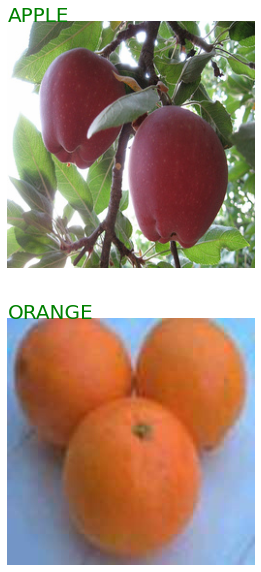

In [0]:
f, axarr = plt.subplots(2,1, figsize=(20,10))

for i in range(2):
        if i==0:
            x = val_real_A
            s='APPLE'
        else :
            x = val_real_O
            s='ORANGE'

        grid = torchvision.utils.make_grid(x.clamp(min=-1, max=1), scale_each=True, normalize=True)
        """
        Turn off axis
        """
        axarr[i].set_axis_off()
        """
        Plot image data
        """
        axarr[i].imshow(grid.permute(1, 2, 0).cpu().numpy())

        """
        Add the text for validation image.
        Add the text to the axes at location coordinates.
        """
        axarr[i].text(0.5, 0.05, s, dict(size=20, color='green'))


In [0]:
print('Size of val_real_O before conversion : ',val_real_O.size())
"""
Specific train and test images of each domain  are converted to  B * C * W * H.
"""
print('\nSpecific train and test images of each domain  are converted to  B * C * W * H')
train_real_A = torch.stack([train_real_A])
print('Size of train_real_A : ',train_real_A.size())
train_real_O = torch.stack([train_real_O])
print('Size of train_real_O : ',train_real_O.size())

val_real_A = torch.stack([val_real_A])
print('Size of val_real_A : ',val_real_A.size())
val_real_O = torch.stack([val_real_O])
print('Size of val_real_O : ',val_real_O.size())


y=torch.squeeze(val_real_O).permute(1, 2, 0)
print('\nSize of y after torch squeeze and permute : ',y.size())

"""
Getting Image shape which will be passed to summary function to get modules output saphe and parameter summary
"""
z=torch.squeeze(val_real_O)
print('\nPreparing the image shape that will be used in summary function later : ',z.size())

Size of val_real_O before conversion :  torch.Size([3, 256, 256])

Specific train and test images of each domain  are converted to  B * C * W * H
Size of train_real_A :  torch.Size([1, 3, 256, 256])
Size of train_real_O :  torch.Size([1, 3, 256, 256])
Size of val_real_A :  torch.Size([1, 3, 256, 256])
Size of val_real_O :  torch.Size([1, 3, 256, 256])

Size of y after torch squeeze and permute :  torch.Size([256, 256, 3])

Preparing the image shape that will be used in summary function later :  torch.Size([3, 256, 256])


**Showing Some Train Images**

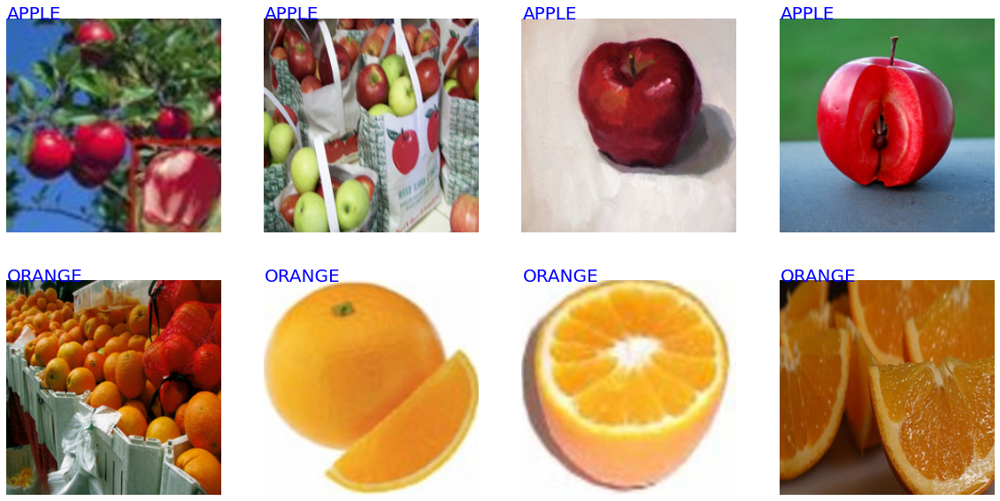

In [0]:
def set_seed(seed):
    torch.manual_seed(seed)
    np.random.seed(seed)

set_seed(42)

img_idx_lst=np.random.randint(0,1000,8)

def show_images(data_X, data_Y):
    rows, cols,=2, 4
    f, axarr = plt.subplots(rows,cols, figsize=(20,10))

    for i in range(rows):
        for j in range(cols):
            if i==0:
                x = data_X.__getitem__(img_idx_lst[i*4+j])
                s='APPLE'
            else :
                x = data_Y.__getitem__(img_idx_lst[i*4+j])
                s='ORANGE'

            grid = torchvision.utils.make_grid(x.clamp(min=-1, max=1), scale_each=True, normalize=True)
            """
            Turn off axis
            """
            axarr[i,j].set_axis_off()
            """
            Plot image data
            """
            axarr[i,j].imshow(grid.permute(1, 2, 0).cpu().numpy())

            """
            Add the text for validation image.
            Add the text to the axes at location coordinates.
            """
            axarr[i,j].text(0.5, 0.05, s, dict(size=20, color='blue'))
    

show_images(train_data_X, train_data_Y)

### **Required Functions**

[subplots_adjust](https://matplotlib.org/api/_as_gen/matplotlib.pyplot.subplots_adjust.html)

In [0]:
def to_numpy_and_scale(x):
   """
   Function to prepare the image tensor to work with matplotlib 
   """
   grid = torchvision.utils.make_grid(x.clamp(min=-1, max=1), scale_each=True, normalize=True)
   
   return grid.permute(1, 2, 0).detach().cpu().numpy()
   

def generate_result(real_image, gen_image, recon_image, epoch, result_dir, is_test=False, show=False):
    """
    Create and conditinaly show real image with fake and reconstructed images generated by generators.
    This function is used to generate both train and test result based on parameters.
    """
    titles = ['Real', 'Generated', 'Reconstructed']
    if is_test:
        images=[to_numpy_and_scale(real_image[0]),  to_numpy_and_scale(gen_image[0]), to_numpy_and_scale(recon_image[0])]
        fig, axarr = plt.subplots(1, 3, figsize=(10,10))
    else:
        images = [to_numpy_and_scale(real_image[0]), to_numpy_and_scale(gen_image[0]), to_numpy_and_scale(recon_image[0]),
                  to_numpy_and_scale(real_image[1]), to_numpy_and_scale(gen_image[1]), to_numpy_and_scale(recon_image[1])]
                    
        fig, axarr = plt.subplots(2, 3, figsize=(10,10))

    for i in range(len(images)):
        if not is_test:
            if i < 3:
                nrows=0
                ncols=i
                
                title_i=i
            else:
                nrows=1
                ncols=i - 3
                title_i=i-3
            ax=axarr[nrows][ncols]
        else:
            title_i=i
            ax=axarr[i]
            
  
        """
        Turn off axis of the plot
        """
        ax.set_axis_off()
        """
        Plot image data
        """
        
        ax.imshow(images[i], aspect='equal')
        """
        Set Title of individual subplot
        """
        ax.set_title(titles[title_i], color='red', fontsize = 16)
    """
    Tune the subplot layout
    """
    plt.subplots_adjust(wspace=0, hspace=0)

    if not is_test:
        """
        Add the text for train and validation image.
        Add the text to the axes at location coordinates.
        """
        fig.text(0.5, 0.05, 'Epoch {}'.format(epoch + 1), horizontalalignment='center', fontsize=16, color='red')

    """
    Save every plot.
    """
    if not is_test:
        result_file = os.path.join(result_dir,'CycleGAN_Result_Epoch_{}'.format(epoch+1) + '.png')
    else:    
        result_file = os.path.join(result_dir + 'CycleGAN_Test_Result_{}'.format(epoch + 1) + '.png')

    plt.savefig(result_file)

    """
    Display(Conditional)
    """
    if show and is_test:
         plt.show()
    else:
        plt.close()


def real_gen_recon_image(G_1,G_2,real_image):
    """
    This function is used to generate fake and reconstructed images generated by generators
    """
    """
    Move image to the device.
    """
    real_image = real_image.to(device)

    """
    Real To Genereted To Reconstruction
    """
    fake_image = G_1(real_image)
    reconstructed_image = G_2(fake_image)

    return fake_image,reconstructed_image


>As per the **[Paper](https://arxiv.org/pdf/1703.10593.pdf)** : "*Second, to reduce model oscillation [15], we follow Shrivastava et al.’s strategy [46] and update the discriminators using a history of generated images rather than the
ones produced by the latest generators. We keep an image
buffer that stores the 50 previously created images*"

Calculating the discriminator loss for each generated image is computationally expensive. To speed up training as per the [Paper](https://arxiv.org/abs/1703.10593) I store a collection of previously generated images of each domain which is used to update the discriminator models instead of latest generated image.First, populate the image buffer of size 50 one by one until its reaches the capacity and after that probabilistically either add latest image to the buffer by replacing an existing image(For more than 50% probability) or use a generated fake image directly(For 50% or less probability).The history of image buffer helps the discriminator not to forget what it has done wrong before.

In [0]:
def update_image_buffer_and_get_image(image_buffer, input_images, capacity):

    if capacity == 0:
        return input_images

    return_images = []

    for input_image in input_images.data:
        input_image = torch.stack([input_image])
        """
        Populate the image buffer one by one until its reaches the capacity.
        """
        if len(image_buffer) < capacity:
            image_buffer.append(input_image)
            return_images.append(input_image)

        elif random.random() > 0.5:
            """
            Probabilistically, replace an existing fake image and use replaced fake image.
            """
            randId = random.randint(0, capacity-1)
            return_images.append(image_buffer[randId])
            image_buffer[randId] = input_image
        else:
            """
            Probabilistically, uses a generated fake image directly.
            """
            return_images.append(input_image)
            
    return_images = torch.cat(return_images, 0)
  
    return return_images

## **CycleGAN Model Creation**


**Conv2d**

$H_{out}$=$$\frac{H_{in} + 2×padding[0]
−dilation[0]×(kernel_size[0]−1)−1}{stride[0]} + 1$$
​	


$W_{out}$ = $$\frac{W_{in} + 2 × padding[1] - dilation[1] × (kernel_size[1] - 1) - 1}{stride[1]} + 1$$


**ConvTranspose2d**

$H_{out}$ = ($H_{in}$ - 1) × stride[0] - 2 ×padding[0] + dilation[0] × (kernel_size[0] - 1) + output_padding[0] + 1

$W_{out}$ = ($W_{in}$ - 1) × stride}[1] - 2 ×padding[1] + dilation[1] × (kernel\_size[1] - 1) + output_padding[1] + 1


**ReflectionPad2d**

$H_{out}$ = $H_{in}$ + padding_top + padding_bottom

$W_{out}$ = $W_{in}$ + padding_left+ padding_right

[Formula Link](https://pytorch.org/docs/stable/nn.html)

[Residual Block and Module Dict and Model Summary](https://towardsdatascience.com/residual-network-implementing-resnet-a7da63c7b278)

**ModuleDict For various Activation Functions**

ModuleDict is used to parameterize some blocks of model, for example an activation function

In [0]:
def activation_func(activation_name):
    return  nn.ModuleDict([
        ['relu', nn.ReLU(inplace=True)],
        ['leaky', nn.LeakyReLU(0.2, inplace=True)],
        ['tanh', nn.Tanh()],
        ['none', nn.Identity()]
    ])[activation_name]

pad_func=lambda kernel_size: (kernel_size-1)//2

**Conv2D Layer With Normalization And Activation Layer Creation Function**

In [0]:
class Conv(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size=3, stride=2, padded=False, activation='relu', norm=True):
        super().__init__()

        kernel = (kernel_size,kernel_size)
        """
        if Reflection pad is used, set padding param to 0 as already padded 
        """
        padding = pad_func(kernel_size) if not padded else 0 

        self.conv = nn.Conv2d(in_channels,out_channels,kernel,stride,padding)
        self.norm = norm
        self.ins = nn.InstanceNorm2d(out_channels)
        self.activation = activation_func(activation)
        

    def forward(self,x):

        if self.norm:
            x = self.ins(self.conv(x))
        else:
            x = self.conv(x)

        return self.activation(x)

****ConvTranspose2D Layer With Normalization And Activation Layer Creation Function****

In [0]:
class Deconv(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size=3, stride=2):
        super().__init__()

        pad = pad_func(kernel_size)
        out_pad=pad
        kernel = (kernel_size,kernel_size)

        self.deconv = nn.ConvTranspose2d(in_channels,out_channels,kernel,stride,pad,out_pad)
        self.ins = nn.InstanceNorm2d(out_channels)
        self.relu = activation_func('relu')

    def forward(self,x):
            x = self.relu(self.ins(self.deconv(x)))
            return x

**Residual Block**

Due to the vanishing or exploding gradient problem deeper neural networks are more difficult to train.Deeper neural networks troubled reaching convergence.The solution to this problem is residual block which uses a the the output from the previous layer known as residual to compute the output at a given layer. 

The trick here is, the skip-connection that will be used only addition along the skips, so that the gradient remains easy to compute and information is not mutated by complex operations.

[Residual Block and Module Dict and Model Summary](https://towardsdatascience.com/residual-network-implementing-resnet-a7da63c7b278)

![title](https://miro.medium.com/max/1600/1*FqmD91PvbH7NKCnQWFJxvg.png)

The residual strategy equation generally looks like :  

$$\boldsymbol{h} = \text{ReLU}\left(\boldsymbol{x} + F(\boldsymbol{x})\right)$$

where $F(\cdot)$ represents a small sequence convolutions, normalization, and activation functions repeated twice. This has the effect of creating skip connections and make it easier to learn deeper networks with more layers. The deeper networks tend to converge faster and to a better quality solution. 

* As per the **[Paper](https://arxiv.org/pdf/1703.10593.pdf)** :

>"*4. ImplementationNetwork Architecture We adopt the architecture for ourgenerative networks from Johnson et al. [23] who haveshown impressive results for neural style transfer and superresolution.*"

[CycleGAN Discussion](https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix/issues/595)
[CycleGAN All Discussion](https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix/issues)

[fast-neural-style](https://github.com/jcjohnson/fast-neural-style/blob/master/doc/flags.md)

>"*What type of padding to use for convolutions in residual blocks.?
The following choices are available:
zero: Normal zero padding everywhere.
none: No padding for convolutions in residual blocks.
reflect: Spatial reflection padding for all convolutions in residual blocks.
replicate: Spatial replication padding for all convolutions in residual blocks.
reflect-start (default): Spatial reflection padding at the beginning of the model and no padding for convolutions in residual blocks.*"

As per the paper I use reflection padding to use for convolutions in residual blocks.I think, as reflection padding reflect the row into the padding, saptial information are kept in padding unlike zero padding where padding keep the image size same but pad with zero value no spatial information.Conv layer take advantage of some spatial correlation which is learne by the model and create better result utilizing the spatiality and unlike zero pad it does not change feature distribution.

In [0]:
class ResidualBlock(nn.Module):
    def __init__(self, channels, kernel_size=3, stride=1):
        super().__init__()
        """
        Input and channel remain same (i.e. 256 ==> R256 as per paper.)
        Keeping stride = 1 to maintain the shape.This two also eleminate Shortcut part to make 1x1 convolution as a "projection". 
        """
        """
        128*64*64 To 128*66*66
        """
        pad=pad_func(kernel_size)
        self.reflection_pad = nn.ReflectionPad2d(pad)
        """
        128*64*64 To 128*64*64  
        then reflection_pad so 128*64*64 To 128*66*66
        """
        self.conv1 = Conv(channels,channels,kernel_size,stride=stride,padded=True)
        """
        128*66*66 To 128*64*64
        """
        self.conv2 = Conv(channels,channels,kernel_size,stride=stride,padded=True,activation='none')
      
        self.relu1 = activation_func('relu')

        """
        Shortcut part is the identify function, which returns the input as the output
        Unless the output of will have a different shape due to a change in
        the number of channels or stride, then we will make the short cut
        a 1x1 convolution as a "projection" to change it's shape.
         
        Which in this case will never execute as channels are same and stride=1. Hence skiping that part.
        """ 
          

    def forward(self,x):
        """
        Compute the results of F_x and x, as needed 
        """
        residual=x
        f_x = self.conv1(self.reflection_pad(x))
        f_x = self.conv2(self.reflection_pad(f_x))
        x = self.relu1(residual + f_x)
        return x

**Genereator**

* As per the **[Paper](https://arxiv.org/pdf/1703.10593.pdf)** :

>**7.2. Network architectures -->Generator architectures -->**"*We use 6 residual blocks for
128 × 128 training images, and 9 residual blocks for 256 ×
256 or higher-resolution training images.*"

>"*Let c7s1-k denote a 7×7 Convolution-InstanceNormReLU layer with k filters and stride 1. dk denotes a 3 × 3
Convolution-InstanceNorm-ReLU layer with k filters and
stride 2. Reflection padding was used to reduce artifacts.
Rk denotes a residual block that contains two 3 × 3 convolutional layers with the same number of filters on both
layer. uk denotes a 3 × 3 fractional-strided-ConvolutionInstanceNorm-ReLU layer with k filters.*"

>"*The network with 9 residual blocks consists of:*"
**c7s1-64,d128,d256,R256,R256,R256,
R256,R256,R256,R256,R256,R256,u128
u64,c7s1-3**

* The generator consists encoder and decoder. It downsample or encode the input image, then interpret the encoding with 9 Residual Blocks having skip connections.After that with a a series of layers it upsample or decode the representation to the size of the fake image.

* Reflection padding “reflects” the row into the padding. It is used mostly for brightness, contrast and for reducing artifact.

*  Batch norm normalizes across the mini batch of definite size.On the other hand, Instance normalization normalizes across each channel in each data instead of normalizing across input features in a data.Instance Norm normalizes each batch independently and across spatial locations only.

* Use of instance normalization layers, the normalization process allows to remove instance-specific contrast information from the  image content, which simplifies image generation. Thus results in vastly improved images.

* CycleGAN paper uses batch size as 1. This also indicate that as it consideres 1 image at a time batch normalization can not be used here instead need to use instance normalization.

![title](https://i1.wp.com/mlexplained.com/wp-content/uploads/2018/11/Screen-Shot-2018-11-28-at-4.56.06-PM.png?w=522&ssl=1)

[Reflection Padding](https://www.machinecurve.com/index.php/2020/02/10/using-constant-padding-reflection-padding-and-replication-padding-with-keras/)

[Instance Normalization:
The Missing Ingredient for Fast Stylization](https://arxiv.org/pdf/1607.08022.pdf)

In [0]:
class Generator(nn.Module):
    def __init__(self, in_channels, n_filter, out_channels, n_residual_blocks,kernel_size=7):
        super().__init__()
        """
        Component of generator : 
            * Initial Convolution Block
            * Encoder
            * Residual blocks
            * Decoder
            * Output Convolution Block

        kernel_size=7 for two conv layers : Initial Convolution Block and Output Convolution Block.
        But rest conv layers of encoder and residual block or deconv layers of decoder have 3 as kernal size which is by defalut initialzed
        by the Conv and Deconv class.
        """

        """
        Initial Convolution Block
        Reflection padding ==> 3*256*256 To 3*262*262
        c7s1-64 ==>#3*262*262 To 64*256*256

        Generator input size is  3 * 256 * 256
        As per paper, this initial conv layer will have kernel size=7 so inorder to keep the image size (W,H) same 
        we need to pad it by padding of size (kernel_size-1)//2 =7-1//2 = 3
        As per paper I use Reflection padding to reduce artifact.
        """
        pad = pad_func(kernel_size)
        generator = nn.ModuleList([nn.ReflectionPad2d(pad), #3*256*256 To 3*262*262
                     Conv(in_channels,n_filter,kernel_size=kernel_size,stride=1,padded=True) #3*262*262 To 64*256*256
                    ])
      
        """
        Encoder
        Downsampling
        d128 ==> 64*256*256 To 128*128*128
        d256 ==> 128*128*128 To 256*64*64
        """
        generator += nn.ModuleList([Conv(n_filter,n_filter*2), #64*256*256 To 128*128*128
                      Conv(n_filter*2,n_filter*4)#128*128*128 To 256*64*64
                     ])

        """
        Residual blocks : R256,R256,R256,R256,R256,R256,R256,R256,R256
        ==> 256*64*64 To 256*64*64
        """
      
        generator +=nn.ModuleList([ResidualBlock(n_filter*4) for i in range(n_residual_blocks)])#256*64*64 To 256*64*64
        
        """
        Decoder
        Upsampling
        u128 ==> 256*64*64 To 128*128*128
        u64 ==> #128*128*128 To 64*256*256 
        """
        generator += nn.ModuleList([Deconv(n_filter*4,n_filter*2),#256*64*64 To 128*128*128
                      Deconv(n_filter*2,n_filter)#128*128*128 To 64*256*256 Then reflection_pad so 64*256*256 To 64*262*262
                     ])
        
        """
        Output Layer
        Then reflection_pad so 64*256*256 To 64*262*262
        c7s1-3 ==> 64*262*262 To 3*256*256 

        The previous decoder gives image outcome of size 64*256*256.
        Discriminator takes image of size 3*256*256
        As per paper, this output conv layer will have kernel size=7 
        so inorder to keep the image size (W,H) same 
        need to pad it by padding of size (kernel_size-1)//2 =7-1//2 = 3
        As per paper I use Reflection padding to reduce artifact.
        """
        generator += nn.ModuleList([nn.ReflectionPad2d(pad),
                      Conv(n_filter,out_channels,kernel_size=kernel_size,stride=1,padded=True,activation='tanh',norm=False)#64*262*262 To 3*256*256
                     ])
        
        self.generator = nn.Sequential(*generator)

    def forward(self,x):
        return self.generator(x)


**Discriminator**

* As per the **[Paper](https://arxiv.org/pdf/1703.10593.pdf)** :

>**7.2. Network architectures -->Discriminator architectures -->**"*For discriminator networks, we use 70 × 70 PatchGAN [22]. Let Ck denote a
4 × 4 Convolution-InstanceNorm-LeakyReLU layer with k
filters and stride 2. After the last layer, we apply a convolution to produce a 1-dimensional output. We do not use
InstanceNorm for the first C64 layer. We use leaky ReLUs
with a slope of 0.2. The discriminator architecture is:*"
**C64-C128-C256-C512**

[Visual Receptive Field Calculator]( https://fomoro.com/tools/receptive-fields/#)

[PatchGAN](https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix/issues/39)
> "I converted the math into python to make it easier to understand:
```python
def f(output_size, ksize, stride):
    return (output_size - 1) * stride + ksize
last_layer = f(output_size=1, ksize=4, stride=1)
"""Receptive field: 4"""
fourth_layer = f(output_size=last_layer, ksize=4, stride=1)
"""Receptive field: 7"""
third_layer = f(output_size=fourth_layer, ksize=4, stride=2)
"""Receptive field: 16"""
second_layer = f(output_size=third_layer, ksize=4, stride=2)
"""Receptive field: 34"""
first_layer = f(output_size=second_layer, ksize=4, stride=2)
"""Receptive field: 70"""
print(first_layer)"
```

In [0]:
class Discriminator(nn.Module):
    def __init__(self,in_channels,n_filter,out_channels,kernel_size=4):
        super().__init__()
        """
        C64
        3*256*256 To 64*128*128
        """
        discriminator = nn.ModuleList([Conv(in_channels,n_filter,kernel_size=kernel_size,stride=2,activation='leaky',norm=False)])
        """
        C128
        64*128*128 To 128*64*64
        """
        discriminator += nn.ModuleList([Conv(n_filter,n_filter*2,kernel_size=kernel_size,stride=2,activation='leaky')])
        """
        C256
        128*64*64 To 256*32*32
        """
        discriminator += nn.ModuleList([Conv(n_filter*2,n_filter*4,kernel_size=kernel_size,stride=2,activation='leaky')])
        """
        C512
        256*32*32 To  512*31*31
        """
        discriminator += nn.ModuleList([Conv(n_filter*4,n_filter*8,kernel_size=kernel_size,stride=1,activation='leaky')])
        """
        Final layer, so no need of normalization and activation.
        512*31*31 To  1*30*30
        """
        discriminator += nn.ModuleList([Conv(n_filter*8,out_channels,kernel_size=kernel_size,stride=1,activation='none',norm=False)])

        
        self.discriminator =nn.Sequential(*discriminator)
      
    def forward(self,x):
        x = self.discriminator(x)
        return x

* As per the **[Paper](https://arxiv.org/pdf/1703.10593.pdf)** :

>**7.1. Training details-->**"*Weights are initialized from a
Gaussian distribution N (0, 0.02).*"

[nn.Module Children](https://discuss.pytorch.org/t/saving-inputs-of-all-nn-module-children/34937)

[Weight Initialization](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html#weight-initialization)

[Weight And Bias Initialization](https://discuss.pytorch.org/t/how-are-layer-weights-and-biases-initialized-by-default/13073/24)

In [0]:
"""
Weight initialization from a Gaussian distribution N (0, 0.02)
""" 
def weights_init(m):
    for layer in m.children():
        if isinstance(layer, nn.Conv2d) or isinstance(layer, nn.ConvTranspose2d):
            nn.init.normal_(layer.weight, mean=0.0, std=0.02)
            if layer.bias is not None:
                nn.init.zeros_(layer.bias)

**Creation of Generators and Discriminators**

In [0]:
def create_cyclegan_model(n_gen_filter, n_dcrmnt_filter, n_residual_blocks, load_state=False):
    """
    * Creates 2 Generators and 2 Discriminators.
    * In case of restoring the states of original models this function will only create 2 Generators.
    * Place the created models on the correct compute resource (CPU or GPU).
    * Models' weight initialized from a Gaussian distribution N (0, 0.02) except for restoring the states of original models.
    """
    
    """
    Create Generators
    """
    G_XtoY = Generator(in_channels=3, n_filter=n_gen_filter, out_channels=3, n_residual_blocks=n_residual_blocks)
    G_YtoX = Generator(in_channels=3, n_filter=n_gen_filter, out_channels=3, n_residual_blocks=n_residual_blocks)

    """
    Place the models on the correct compute resource (CPU or GPU)
    """
    G_XtoY.to(device)
    G_YtoX.to(device)

    print('Created Generators and move them to the correct compute resource (CPU or GPU)')
   
    """
    Create Discriminators and Place the models on the correct compute resource (CPU or GPU).
    Models' weight initialized from a Gaussian distribution N (0, 0.02)
    """
    if not load_state:
        G_XtoY.apply(weights_init)
        G_YtoX.apply(weights_init)

        print('Generators\' weight initialized from a Gaussian distribution N (0, 0.02)')

        D_X = Discriminator(in_channels=3,n_filter=n_dcrmnt_filter,out_channels=1)
        D_Y = Discriminator(in_channels=3,n_filter=n_dcrmnt_filter,out_channels=1)

        D_X.to(device)
        D_Y.to(device)
        
        print('Created Discriminators and move them to the correct compute resource (CPU or GPU)')
        
        D_X.apply(weights_init)
        D_Y.apply(weights_init)

        print('Discriminators\' weight initialized from a Gaussian distribution N (0, 0.02)')


    if not load_state:
        return G_XtoY, G_YtoX, D_X, D_Y
    else:
        return G_XtoY, G_YtoX

In [0]:
"""
Create Generators and Discriminators Models of CycleGAN
""" 
G_XtoY, G_YtoX, D_X, D_Y = create_cyclegan_model(n_gen_filter=ngf, n_dcrmnt_filter=ndf, n_residual_blocks=num_residual_blocks)

Created Generators and move them to the correct compute resource (CPU or GPU)
Generators' weight initialized from a Gaussian distribution N (0, 0.02)
Created Discriminators and move them to the correct compute resource (CPU or GPU)
Discriminators' weight initialized from a Gaussian distribution N (0, 0.02)


**Created Models Architechture**

In [0]:
def show_cyclegan_architechture(model_dict):
    """
    Show cycleGAN's generators and discriminators architechture.
    """
    print("*"*100)
    print("CycleGAN's Generators And Discriminators Architechture".rjust(75)) 
    print("*"*100 + "\n\n")

    for m in model_dict:
        print("*"*100)
        print(m.rjust(50))
        print("*"*100)
        print(model_dict[m])
        print("*"*100)
        print('\n\n')


"""
Show the structure of all of the models of CycleGAN
"""
show_cyclegan_architechture({'G_XtoY':G_XtoY,
                             'G_YtoX':G_YtoX,
                             'D_X':D_X,
                             'D_Y':D_Y})

****************************************************************************************************
                     CycleGAN's Generators And Discriminators Architechture
****************************************************************************************************


****************************************************************************************************
                                            G_XtoY
****************************************************************************************************
Generator(
  (generator): Sequential(
    (0): ReflectionPad2d((3, 3, 3, 3))
    (1): Conv(
      (conv): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1))
      (ins): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      (activation): ReLU(inplace=True)
    )
    (2): Conv(
      (conv): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (ins): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, t

**Created Models Sumary**

In [0]:
def show_cyclegan_model_summary(gen, discrmnt, shp):
    """
    Show CycleGAN's generators and discriminators output shape and parameters summary.
    """
    print("*"*100)
    print("CycleGAN's Generator And Discriminator Summary".rjust(70)) 
    print("*"*100 + "\n\n")
    print("*"*100)
    print("Generator Summary".rjust(60))
    print("*"*100+ "\n")
    print(summary(gen, shp))
    print("\n\n" + "*"*100)
    print("Discriminator Summary".rjust(60))
    print("*"*100 + "\n")
    print(summary(discrmnt, shp))

"""
Show the summary of CycleGAN's generator and discriminator.
"""
show_cyclegan_model_summary(G_XtoY, D_X, z.size())

****************************************************************************************************
                        CycleGAN's Generator And Discriminator Summary
****************************************************************************************************


****************************************************************************************************
                                           Generator Summary
****************************************************************************************************

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ReflectionPad2d-1          [-1, 3, 262, 262]               0
            Conv2d-2         [-1, 64, 256, 256]           9,472
    InstanceNorm2d-3         [-1, 64, 256, 256]               0
              ReLU-4         [-1, 64, 256, 256]               0
              Conv-5         [-1, 64, 256, 256]               0
            

## **Training of CycleGAN**

* As per the **[Paper](https://arxiv.org/pdf/1703.10593.pdf)** :

>"*We apply adversarial losses [16] to both mapping functions. For the mapping function G : X → Y and its discriminator DY , we express the objective as:*" 

> **(Equation 1)**  $$L_{GAN}(G, D_{Y} , X, Y ) = E_{y∼pdata(y)}
[log D_{Y}(y)] + E_{x∼pdata(x)}
[log(1 − D_{Y}(G(x))]$$.      

>"*Adversarial training can, in theory, learn mappings G
and F that produce outputs identically distributed as target
domains Y and X respectively (strictly speaking, this requires G and F to be stochastic functions) [15]. However,
with large enough capacity, a network can map the same
set of input images to any random permutation of images in
the target domain, where any of the learned mappings can
induce an output distribution that matches the target distribution. Thus, adversarial losses alone cannot guarantee
that the learned function can map an individual input $x_{i}$
to
a desired output $y_{i}$.To further reduce the space of possible mapping functions, we argue that the learned mappingfunctions should be cycle-consistent: as shown in Figure 3
(b),for each image x from domain X, the image translation
cycle should be able to bring x back to the original image,
i.e., x → G(x) → F(G(x)) ≈ x. We call this forward cycle consistency. Similarly, as illustrated in Figure 3 (c), for
each image y from domain Y , G and F should also satisfy
backward cycle consistency: y → F(y) → G(F(y)) ≈ y.
We incentivize this behavior using a cycle consistency loss:*"

CycleGAN intution of cycle-consistency loss $L_{cyc}$(G, F)  to ensure x→G(x)→F(G(x))≈x as well as : y → F(y) → G(F(y)) ≈ y.

>**(Equation 2)** $$L_{cyc}(G, F) = E_{x∼pdata(x)}
[\lVert F(G(x)) − x \rVert_{1}] + E_{y∼pdata}(y)
[ \lVert  G(F(y)) − y\rVert_{1}]$$. 

The combined GAN and cycle-consistency loss :

>**(Equation 3)** $$L(G, F, D_{X}, D_{Y}) =L_{GAN}(G, D_{Y} , X, Y ) + L_{GAN}(F, D_{X}, Y, X) + λL_{cyc}(G, F)$$. 

The final math is to minimize the combined loss for the generator, while maximizing the loss for the discriminator.

>"*where λ controls the relative importance of the two objectives. We aim to solve:*"

>**(Equation 4)** $$G^∗, F^∗ = \arg\min_{G,F} \max_{D_X,D_Y}L(G, F, D_X, D_Y)$$


>"*We apply two techniques from recent
works to stabilize our model training procedure. First,
for LGAN (Equation 1), we replace the negative log likelihood objective by a least-squares loss [35]. This loss is
more stable during training and generates higher quality
results. In particular, for a GAN loss $L_{GAN}$(G, D, X, Y ),
we train the G to minimize $E_{x∼pdata(x)}$
$[(D(G(x)) − 1)^2$] and train the D to minimize $E_{y∼pdata(y)}$
$[(D(y) − 1)^2]$ + $E_{x∼pdata(x)}$ 
$[D(G(x))^2
]$.*"

>"*For all the experiments, we set **λ = 10** in Equation 3.
We use the Adam solver [26] with a **batch size of 1**. All
networks were **trained from scratch with a learning rate of
0.0002.We keep the same learning rate for the first 100
epochs and linearly decay the rate to zero over the next 100
epochs**.*"

>"*We train our networks from scratch, with a learning rate
of 0.0002. In practice, we divide the objective by 2 while
optimizing D, which slows down the rate at which D learns,
relative to the rate of G.*"

* As per the paper, I use the parameter values, loss function with AdamW
instead of Adam optimizer.

* As per the paper, I multiplied the loss for the discriminators by 0.5 during training, in order to slow down updates to the discriminator relative to the generators model during training.Discriminators have intrinsically easier problem to solve(just classifications) than generators.It becomes easy for  discriminators to "win the game" again the generators.So,Discriminators easily converge ,classifications will be perfect there will be no gradient for  generators  to learn from  and the generators are dependent on back propegating through  discriminators. In order to have a "fair fight" between generators and discriminators the total loss of discriminator is divided by 2 to slow done discriminators progress which will make it easier for the generators to learn.
Now generator will have twice times span to learn on back propegating through  discriminators.

* As per the paper, for optimization using least squares loss (L2) implemented as mean squared error for better stability during traing and high quality results.

* As Per **[Least Squares Generative Adversarial Networks Paper](https://arxiv.org/pdf/1611.04076.pdf)**
>"*Least Squares Generative Adversarial Networks (LSGANs) which
adopt the least squares loss function for the discriminator. The idea is simple
yet powerful: the least squares loss function is able to move the fake samples
toward the decision boundary, because the least squares loss function penalizes
samples that lie in a long way on the correct side of the decision boundary. As
Figure 1(c) shows, the least squares loss function will penalize the fake samples
(in magenta) and pull them toward the decision boundary even though they
are correctly classified. Based on this property, LSGANs are able to generate
samples that are closer to real data.
Another benefit of LSGANs is the improved stability of learning process.*"
* **LambdaLR learning rate scheduler** is used for linear deacy of learning rate. LambdaLR sets the learning rate of each parameter group to the initial lr times a given function. 
  * In-order to linera decay of learning rate after 100 epoch the lambda function checks whether the current epoch has exceeds the decay epoch(which is 100) if current epoch less than start of decay epoch(which is 100) it returns 1. So that initialr lr remain same for the first 100 epochs. 
  * If the current epoch has exceeds the decay epoch(which is 100) the iniltial lr will be decreased through out the rest of the epoch among total epochs(rest 100 epoch out of total 200 epochs of training).
  * If we equally divide the lr for the last 100 epochs and keep subtracibg from base lr it will reach to 0. 
  * As lambda lr multiply initial lr with given function, epoch beyond the decay epoch will sum up the consistent decrease in lr value from staring of decay epoch(which is 100) to the current epoch(for example 110)).As it does not have the decayed lr at previous epochs(here epoch 109 in case of current epoch 110) and only have base lr it sum up the decrement occured in lr for the previous epoch.

* **Generator Loss** 
  * Generators should be able to outsmart the discriminator about the authencity of the generated images. This can done if the discriminator classification for the generated images is close to 1. So generators would like to minimize :
   * $(D_{Y}(G_{XtoY}(X))−1)^2$ 
   * $(D_{X}(G_{YtoX}(Y))−1)^2$ 

* **Cycle Consistency Loss**
 * For my project, cycle consistency loss is critical. Cycle consistency comes from the concepts of language translation. It assumes that when we translate from English to Bengali and back from Bengali to English, the original sentence should be obtained. In this project we have used generators, that might be capable of generating plausible images in the target domain. But are not necessarily translations of the input image. That is why, the generators need to be updated with a sense of consistency through its cycles of translations. This notion of cycle consistency allows us to get to the input image using another generator and thus the difference between the real image and the translated image should be as small as possible. Cycle consistency loss compares the input image to the reconstructed image from the CycleGAN and calculates the summed absolute difference of pixel values between the said images using the L1 norm.

 * The regularization for CycleGAN  is accomplished by cycle consistency, an additional loss to measure the difference between the generated fake image and the real image, and the reverse. Penalizing the generators for not learing the distribution or characteristics of other domain, forcing them to learn the characteristics of new domain and perfrom perfect image translation.

  * There are two types of Cycle Consistency Loss: 
    * Forward Cycle Consistency Loss (cyclic loss for reconstruction of image of domain X)
        $$L_{cyc_x} =(G_{YtoX}(G_{XtoY}(X)) - X) \times 10.0 $$ 
    * Backward Cycle Consistency Loss (cyclic loss for reconstruction of image of domain Y)
        $$L_{cyc_Y} =(G_{XtoY}(G_{YtoX}(Y)) - Y) \times 10.0$$ 


* **Finally, Total Loss of Generators**

     * $(D_{Y}(G_{XtoY}(X))−1)^2$  + $(D_{X}(G_{YtoX}(Y))−1)^2$ +  $L_{cyc_X}$ + $L_{cyc_Y}$ ........(Equation I)

* **Discriminator Loss**
  * The discriminator is working to become better at correctly classify the real and fake images. The discriminator has two types of losses:
    * Real loss
    * Fake loss
  * Discriminator $D_X$ needs to be trained in such a way that real images from domain $X$ should be close to 1, and vice versa for discriminator $D_Y$. So Discriminators would like to minimize the value of:
   * $(D_{X}(X)−1)^2$  
   * $(D_{Y}(Y)−1)^2$
   
 *  Since discriminators should be able to detect the difference between generated and real images it should predict 0 for images generated by the generator. So, Discriminators would like to minimize:
   * $(D_{X}(G_{YtoX}(Y)))^2$ 
   * $(D_{Y}(G_{XtoY}(X)))^2$

 * As I have alreday discussed that, as per the paper, I multiplied the loss for the discriminators by 0.5 during training, in order to slow down updates to the discriminator relative to the generators model.

* **Finally, Total Loss for  $D_X$ :**
  * ( $(D_{X}(X)−1)^2$ + $(D_{X}(G_{YtoX}(Y)))^2$ ) $\times 0.5$ 
   ..................(Equation II)

* **Finally Total Loss for $D_Y$ :**
  * ( $(D_{Y}(Y)−1)^2$ + $(D_{Y}(G_{XtoY}(X)))^2$ )  $\times 0.5$
    ................(Equation III)
* **Train of a neural network model**

(Explaining in,term of Pytorch function inspired by your lecture 2)

Let's ,denote, $\boldsymbol{x}$ as input features, and $f()$ to denote model. If there is a label associated with $\boldsymbol{x}$, then it will be denoted as $y$. Model takes in $\boldsymbol{x}$, and produces a prediction $\hat{y}$. This becomes $\hat{y} = f(\boldsymbol{x})$. Model needs to have some parameters to adjust to provide better prediction, so model's behavior can be changed.Adapt what need to be correct to give good result which is the main goal. $\Theta$ in abstract denotes _all_ the parameters of a model. $\hat{y} = f_\Theta(\boldsymbol{x})$ to state that the model's prediction and behavior is dependent on the value of it's parameters $\Theta$ also known as the "state" of the model.

Goal is to minimize _loss function_ function which _quantifies_ just how badly model is doing at the goal of predicting the ground truth $y$. If $y$ is goal, and $\hat{y}$ is the prediction, then loss function is denoted $\ell(y, \hat{y})$. If there is training set with $N$ examples, the equation is :

$$\min_{\Theta} \sum_{i=1}^N \ell(f_\Theta(\boldsymbol{x}^{(i)}), y^{(i)}) $$

The summation ($\sum_{i=1}^N$) is going over all $N$ pairs of input ($\boldsymbol{x}^{(i)}$) and output ($y^{(i)}$), and determining just how badly ($\ell(\cdot,\cdot)$) are doing. To accomplish the same $\Theta$ is adjusted by gradient descent. If $\Theta_k$ is the _current_ state of our model, which needs to improve, then the next state $\Theta_{k+1}$, that hopefully reduces the loss of the model in terms of math equation is:

$$\Theta_{k+1} = \Theta_k - \eta \cdot \frac{1}{N} \sum_{i=1}^{N} \nabla_{\Theta}\ell(f_{\Theta_k}(\boldsymbol{x}^{(i)}), y^{(i)})$$


The above equation shows the math for _gradient decent_. We follow the gradient ($\nabla$) to tell us how to adjust $\Theta$. As PyTorch provides us with automatic differentiation, useing the PyTorch API and framework we can easily compute $\nabla_{\Theta}$. and don't have to keep track of everything inside of $\Theta$ either. $\eta$ is learning rate,the step size.

For traing we _need_ :
1. Model $f(\cdot)$ to compute
$f_\Theta(\boldsymbol{x}^{(i)})$
I have alreday created 2 generators and 2 discriminators for CycleGAN.
2.PyTorch stores gradients in a mutable data structure.To set a clean state before we use it, optimizer.zero_grad() is used.
3.Loss function $\ell(\cdot,\cdot)$ to compute loss. I have alreday shown the different loss functions required specifically for CycleGAN.
4.loss.backward() to compute gradient $\nabla_{\Theta}$ .
5.optimizer.step() to update all parameter, to perform Θ_{k+1} = Θ_k − η * ∇_Θ ℓ(y_hat, y) 

$$\Theta_{k+1} = \Theta_k - \eta \cdot \frac{1}{N} \sum_{i=1}^{N} \nabla_{\Theta}\ell(f_{\Theta_k}(\boldsymbol{x}^{(i)}), y^{(i)})$$
6.Grabb losses for polting them.

*All I want to say*, I repeat the above 6 steps for the 2 generators and 2 discriminators keeping in mind the individual losses(Total loss of generators ,Total loss of  Discriminator D_X,and D_X as per Equation I, II and III) required to compute in-order to generate pausible fake image,the transaltion of input image, for train CycleGAN.I start traing with Generator keeping in mind the cycle diagram shown in the fisrt markdown cell.

forward cycle: x → G(x) → F(G(x)) ≈ x, and backward cycle: y → F(y) → G(F(y)) ≈ y.

Then train the discriminators. Generator can learn from discriminators what generators need to adjust to fool the discriminator through the response of discriminator about how realistic the fake generated image.

Also did leraning rate adjustment using LambdaLR sheduler and update lr using lr_sheduler.step() after each epoch of training.


**Also below is the detailed steps of CycleGAN Training**

**Training the Generators**

  1. Generate using generator $G_{XtoY}$  $fake_{Y}$ fake images that look like domain $Y$ based on real $real_{X}$ images of domain $X$.
  2. Compute the generator loss based on the response of $D_Y$.
  3. Generate using generator $G_{YtoX}$ reconstructed $reconstructed_X$ images based on the $fake_Y$ fake images generated in step 1.
  4. Compute the cycle consistency loss by comparing the reconstructed $reconstructed_X$ images with real $real_X$  images of domain $X$.
  5. Generate using generator $G_{YtoX}$ $fake_{X}$ fake images that look like domain $X$ based on real $real_{Y}$ images of domain $Y$.
  6. Compute the generator loss based on the respondse of $D_X$.
  7. Generate using generator $G_{XtoY}$ reconstructed $reconstructed_Y$ images based on the $fake_X$ fake images generated in step 5.
  8. Compute the cycle consistency loss by comparing the reconstructed $reconstructed_Y$ images with real $real_Y$ images of domain $Y$.
  9. Add up all the generators loss and cyclic loss (Equation 3 of paper and code representation of the same equation shown in Equation I) and perform backpropagation with optimization.

**Training the Discriminators**

  1. Compute $DX_{real loss}$, the real loss of discriminator $D_X$  on real $real_X$ images of domain X.
  2. Get generated $fake_X$ fake images from Image Buffer that look like domain $X$ and based on real images in domain $Y$.
  3. Compute $DX_{fakeloss}$, the fake loss for discriminator $D_X$ on fake images generated by generator.
  4. Compute the total loss for $D_X$(Equation II), perform backpropagation and $D_X$ optimization.
  5. Compute $DY_{real loss}$, the real loss of discriminator $D_Y$  on real $real_Y$ images.
  6. Get generated $fake_Y$ fake images from Image Buffer that look like domain $Y$ and based on real images in domain $X$.
  7. Compute $DY_{fakeloss}$, the fake loss for discriminator $D_Y$ on fake images.
  8. Compute the total loss for $D_Y$(Equation III), perform backpropagation and $D_Y$ optimization

**Few Final activities :**
  * Capturing various losses in result dictionary which will be used to generate  plot of losses during CycleGAN training.

  * Generating result for a specific train image and a specific test image of each domain to see the progress in fake image generation.

  * Saving the Generators and discriminators state checkpoint. A state_dict is simply a Python dictionary object that maps each layer to its the learnable parameters' (i.e. weights and biases) tensor.
  
[LambdaLR](https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate)

[LambdaLR Source Code](https://pytorch.org/docs/stable/_modules/torch/optim/lr_scheduler.html#LambdaLR)

[LR Adjustment](https://discuss.pytorch.org/t/adaptive-learning-rate/320/13)

**Optimizers and Loss Functions**

In [0]:
"""
The AdamW optimizer is a good default optimizer.
As per Equation 3 of paper(Equivalent Equation I, the code representation)
generators' losses and cycle losses are combined for bakpropagation and 
update state(theta) which indicate to have 
one optimizer for total generator loss with parameter from both generators. 
"""      
generators_parameters = list(G_XtoY.parameters()) + list(G_YtoX.parameters())
optimizer_G = torch.optim.AdamW(generators_parameters,  lr=lr_G, betas=(0.5, 0.999))
optimizer_D_X = torch.optim.AdamW(D_X.parameters(), lr=lr_D, betas=(0.5, 0.999))
optimizer_D_Y = torch.optim.AdamW(D_Y.parameters(), lr=lr_D, betas=(0.5, 0.999))


"""
Loss Functions
"""
mse_criterion = nn.MSELoss()
l1_criterion = nn.L1Loss()

"""
Establish convention for real and fake labels during training
"""
real_label = 1.0
fake_label = 0.0

### **CycleGAN Training**

In [0]:
to_track =["Epochs", "Total_time", "D_X_losses", "D_Y_losses", "G_XtoY_losses", "G_YtoX_losses", "cycle_X_losses", "cycle_Y_losses"]
"""
How long have we spent in the training loop?   
"""
total_train_time = 0     
results = {}

"""
Initialize every item with an empty list.
"""
for item in to_track:
    results[item] = []

"""
Learning rate update schedulers.
Adjust Learing rate : Linear decay of learning rate to zero after 100 epochs.
"""
lambda_lr_func = lambda epoch: 1.0 - max(0, epoch + epoch_offset - decay_epoch) / (epochs - decay_epoch)

lr_scheduler_G   = torch.optim.lr_scheduler.LambdaLR(optimizer_G, lr_lambda = lambda_lr_func)
lr_scheduler_D_X = torch.optim.lr_scheduler.LambdaLR(optimizer_D_X, lr_lambda = lambda_lr_func)
lr_scheduler_D_Y = torch.optim.lr_scheduler.LambdaLR(optimizer_D_Y, lr_lambda = lambda_lr_func)


"""
Creating image buffer of capacity 50 to hold Generated image as per the paper.
"""
buffer_capacity = 50

fake_X_buffer = []
fake_Y_buffer = []


for epoch in tqdm(range(epochs), desc="Epochs", disable=False):
    """
    Put models in training mode.
    """
    G_XtoY = G_XtoY.train()
    G_YtoX = G_YtoX.train()
    D_X = D_X.train()
    D_Y = D_Y.train()

    G_XtoY_running_loss = 0.0
    G_YtoX_running_loss = 0.0
    D_X_running_loss = 0.0
    D_Y_running_loss = 0.0
    cycle_X_running_loss= 0.0
    cycle_Y_running_loss= 0.0
    
    
    
    start = time.time()
    for real_X, real_Y in tqdm(zip(train_loader_X, train_loader_Y), desc="Train Batch", leave=False, disable=False):
        
        """
        Move the batch to the device we are using. 
        """
        real_X = real_X.to(device)
        real_Y = real_Y.to(device)
        
        """
        ****************************** Train Generators *******************************
        
        ***************************** Train Generator G_XtoY **************************
        """

        """
        Generator: G_XtoY: real_X -> Fake_Y 
        Forward Pass Through Generator : First, generate fake_Y fake images and reconstruct reconstructed_X images.
        """
        """
        PyTorch stores gradients in a mutable data structure. So we need to set it to a clean state before we use it. 
        Otherwise, it will have old information from a previous iteration.
        """
        optimizer_G.zero_grad()
        """
        1. G_XtoY Generator generates fake_Y fake images that look like domain Y based on real real_X images of domain X.
        """
        fake_Y = G_XtoY(real_X)
        """
        2. Compute the generator loss based on the response of D_Y.
        """
        D_Y_fake_out = D_Y(fake_Y)#1*1*30*30
        G_XtoY_loss = mse_criterion(D_Y_fake_out, torch.full(D_Y_fake_out.size(), real_label, device=device))
        """
        3. G_YtoX Generator generates reconstructed reconstructed_X images based on the fake_Y fake images generated in step 1.
        """
        reconstructed_X = G_YtoX(fake_Y)
        """
        Forward Cycle Consistency Loss
        Forward cycle loss:  lambda * ||G_YtoX(G_XtoY(X)) - X|| (Equation 2 in the paper)
        4. Compute the cycle consistency loss by comparing the reconstructed reconstructed_X images with real real_X  images of domain X.
           Lambda for cycle loss is 10.0. Penalizing 10 times and forcing to learn the translation. 
        """
        cycle_X_loss = l1_criterion(reconstructed_X, real_X) * 10.0
        
        """
        ***************************** Train Generator G_YtoX **************************
        Generator: G_YtoX: real_Y -> Fake_X
        Backward Pass Through Generator : Now, generate fake_X fake images and reconstruct reconstructed_Y images.
        """
        """
        5. G_YtoX Generator generates fake_X fake images that look like domain X based on real real_Y images of domain Y.
        """
        fake_X = G_YtoX(real_Y)
        """
        6. Compute the generator loss based on the respondse of D_X.
        """
        D_X_fake_out= D_X(fake_X)
        G_YtoX_loss = mse_criterion(D_X_fake_out, torch.full(D_X_fake_out.size(), real_label, device=device))
        """
        7. G_XtoY Generator generates reconstructed reconstructed_Y images based on the fake_X fake images generated in step 5.
        """
        reconstructed_Y = G_XtoY(fake_X)
        """
        Backward Cycle Consistency Loss
        Backward cycle loss: lambda * ||G_XtoY(G_YtoX(Y)) - Y|| (Equation 2)
        8. Compute the cycle consistency loss by comparing the reconstructed reconstructed_Y images with real real_Y images of domain Y.
           Lambda for cycle loss is 10.0. Penalizing 10 times and forcing to learn the translation.
        """
        cycle_Y_loss = l1_criterion(reconstructed_Y, real_Y) * 10.0
        
        """
        Finally, Total Generators Loss and Back propagation
        9. Add up all the Generators loss and cyclic loss (Equation 3 of paper.also Equation I the code representation of the equation) and perform backpropagation with optimization.
        """
        G_loss = G_XtoY_loss + G_YtoX_loss + cycle_X_loss + cycle_Y_loss
        """
        ∇_Θ just got computed by this one call!
        """
        G_loss.backward()
        """
        Now we just need to update all the parameters! 
        Θ_{k+1} = Θ_k − η * ∇_Θ ℓ(y_hat, y)
        """
        optimizer_G.step()
        
        G_XtoY_running_loss+=G_XtoY_loss.item()
        G_YtoX_running_loss+=G_YtoX_loss.item()
        
        cycle_X_running_loss+=cycle_X_loss.item()
        cycle_Y_running_loss+=cycle_Y_loss.item()
        
        """
        ***************************** Train Discriminators ****************************

        *************************** Train Discriminator D_X ***************************
        Discriminator: D_X: G_YtoX(Y) vs. X 
        First, real and fake loss of Discriminator D_X .
        """
        """
        PyTorch stores gradients in a mutable data structure. So we need to set it to a clean state before we use it. 
        Otherwise, it will have old information from a previous iteration.
        """
        optimizer_D_X.zero_grad()
        """
        Train D_X with real real_X images of domain X.
        1. Compute D_X_real_loss, the real loss of discriminator D_X on real real_X images of domain X.
        """
        D_X_real_out = D_X(real_X)
        D_X_real_loss = mse_criterion(D_X_real_out, torch.full(D_X_real_out.size(), real_label, device=device))
        """
        Train with fake_X fake image(History of generated images stored in the image buffer).
        2. Get generated fake_X fake image from Image Buffer that look like domain X and based on real images in domain Y.
        """
        fake_X = update_image_buffer_and_get_image(fake_X_buffer,fake_X,buffer_capacity)
        """
        3. Compute D_X_fake_loss, the fake loss for discriminator D_X on fake images generated by generator.
        """
        D_X_fake_out = D_X(fake_X)
        D_X_fake_loss = mse_criterion(D_X_fake_out, torch.full(D_X_fake_out.size(), fake_label, device=device))
        """
        Back propagation
        As per the paper, I multiplied the loss for the discriminator by 0.5 during training, 
        in order to slow down updates to the discriminator relative to the generator model during training.
        4. Compute the total loss for D_X, perform backpropagation and D_X optimization.(equation II)
        """
        D_X_loss = (D_X_real_loss + D_X_fake_loss) * 0.5
        """
        ∇_Θ just got computed by this one call!
        """
        D_X_loss.backward()
        """
        Now we just need to update all the parameters! 
        Θ_{k+1} = Θ_k − η * ∇_Θ ℓ(y_hat, y)
        """
        optimizer_D_X.step()

        D_X_running_loss+=D_X_loss.item()
        """
        *************************** Train Discriminator D_Y ***************************
        Discriminator: D_Y: G_XtoY(X) vs. Y.
        Now, real and fake loss of Discriminator D_Y.
        """
        """
        PyTorch stores gradients in a mutable data structure. So we need to set it to a clean state before we use it. 
        Otherwise, it will have old information from a previous iteration.
        """
        optimizer_D_Y.zero_grad()
        """
        Train D_Y with real real_Y images.
        5. Compute D_Y_real_loss, the real loss of discriminator D_Y on real real_Y images.
        """
        D_Y_real_out = D_Y(real_Y)
        D_Y_real_loss = mse_criterion(D_Y_real_out, torch.full(D_Y_real_out.size(), real_label, device=device))
        """
        Train with fake fake_Y images(History of generated images stored in the image buffer).
        6. Get generated fake_Y fake images from Image Buffer that look like domain Y and based on real images in domain X.
        """
        fake_Y = update_image_buffer_and_get_image(fake_Y_buffer,fake_Y,buffer_capacity)
        """
        7. Compute D_Y_fake_loss,the fake loss for discriminator D_Y on fake images.
        """
        D_Y_fake_out = D_Y(fake_Y)
        D_Y_fake_loss = mse_criterion(D_Y_fake_out, torch.full(D_Y_fake_out.size(), fake_label, device=device))
        
        """
        Back propagation
        As per the paper, I multiplied the loss for the discriminator by 0.5 during training, 
        in order to slow down updates to the discriminator relative to the generator model during training.
        8. Compute the total loss for D_Y, perform backpropagation and D_Y optimization.(Equation III)
        """
        D_Y_loss = (D_Y_real_loss + D_Y_fake_loss) * 0.5
        """
        ∇_Θ just got computed by this one call!
        """
        D_Y_loss.backward()
        """
        Now we just need to update all the parameters! 
        Θ_{k+1} = Θ_k − η * ∇_Θ ℓ(y_hat, y)
        """
        optimizer_D_Y.step()

        D_Y_running_loss+=D_Y_loss.item()
    
    """
    End training epoch.
    """
    end = time.time()
    total_train_time += (end-start)
    

    """
    Values for plot.
    """
    results["Epochs"].append(epoch)
    results["Total_time"].append(total_train_time)
    results["D_X_losses"].append(D_X_running_loss)
    results["D_Y_losses"].append(D_Y_running_loss)
    results["G_XtoY_losses"].append(G_XtoY_running_loss)
    results["G_YtoX_losses"].append(G_YtoX_running_loss)
    results["cycle_X_losses"].append(cycle_X_running_loss)
    results["cycle_Y_losses"].append(cycle_Y_running_loss)
    
    """
    Generating result for a specific train image of each domain to see the progress in fake image generation.
    """
    train_fake_O, train_reconstructed_A = real_gen_recon_image(G_XtoY,G_YtoX,train_real_A)
    train_fake_A, train_reconstructed_O = real_gen_recon_image(G_YtoX,G_XtoY,train_real_O)


    generate_result([train_real_A, train_real_O], 
                    [train_fake_O, train_fake_A], 
                    [train_reconstructed_A, train_reconstructed_O],
                    epoch,  
                    result_dir=cycleGAN_result_dir)
    """
    Generating result for a specific valiadtion image of each domain to see the progress in fake image generation.
    """
    if val_real_A is None or val_real_O is None :
        pass
    else:
        G_XtoY = G_XtoY.eval()
        G_YtoX = G_YtoX.eval()
        
        val_fake_O, val_reconstructed_A = real_gen_recon_image(G_XtoY,G_YtoX,val_real_A)
        val_fake_A, val_reconstructed_O = real_gen_recon_image(G_YtoX,G_XtoY,val_real_O)


        generate_result([val_real_A, val_real_O], 
                        [val_fake_O, val_fake_A], 
                        [val_reconstructed_A, val_reconstructed_O],
                        epoch, 
                        result_dir=cycleGAN_validation_result_dir)
    
    """
    In PyTorch, the convention is to update the learning rate after every epoch.
    Updating learning rates.
    """
    lr_scheduler_G.step()
    lr_scheduler_D_X.step()
    lr_scheduler_D_Y.step()
    
    """
    Showing lr deacy for few epochs.For 0 to 99 epoch lr is .0002.
    For the next
    Change in value for all optimizers' lr  are same hence showong only one lr.
    """
    if (epoch+1) in [99,100,120,180,199]:
        lr = optimizer_G.param_groups[0]['lr']
        print('optimizer_G\'s learning rate = %.7f' % lr,' at epoch : ', epoch)

    """
    Save the models checkpoint.
    """ 
    torch.save({'epoch'                   : epoch,
                'G_XtoY_state_dict'       : G_XtoY.state_dict(),
                'G_YtoX_state_dict'       : G_YtoX.state_dict(),
                'D_X_state_dict'          : D_X.state_dict(),
                'D_Y_state_dict'          : D_Y.state_dict(),
                'optimizer_G_state_dict'  : optimizer_G.state_dict(),
                'optimizer_D_X_state_dict': optimizer_D_X.state_dict(),
                'optimizer_D_Y_state_dict': optimizer_D_Y.state_dict(),
                'results'                 : results
                }, cycleGAN_checkpoint_dir + 'CycleGAN.pt')
    
"""
Creating DataFrame to hold losses which will be used to generate plot.
"""
results_df =  pd.DataFrame.from_dict(results)

optimizer_G's learning rate = 0.0002000  at epoch :  98


optimizer_G's learning rate = 0.0001980  at epoch :  99


optimizer_G's learning rate = 0.0001580  at epoch :  119


optimizer_G's learning rate = 0.0000380  at epoch :  179


optimizer_G's learning rate = 0.0000000  at epoch :  198


**GIF(Graphics Interchange Format) creation using imageio for a  specific traing and validation image of each domain used in CycleGAN Training and GIF Display**

[GIF creation using imageio](https://stackoverflow.com/questions/41228209/making-gif-from-images-using-imageio-in-python)

[GIF Image Display](https://github.com/ipython/ipython/issues/10045)

I have already created a specific train and validation image of each domain.I have not shown them to the colab notebook. Hence, I created GIF to show the outcome of various epochs as animation all at once.

**Note:** : I am able to create GIF showing animated 200 images.However, colab sometimes could not dispaly the file,It seeems like its unable to load such a huge file.Its not showing any error but runs infinitely. Hence, I reduce the number of image by taking outcome of last 150 epochs to 200 epochs.

In [0]:
def create_and_display_gif(gif_file_name, result_dir, start_epoch=149, show=True):
    """
    GIF Creation and dispaly conditionally
    """
    images = []
    for epoch in range(start_epoch,200):
        file_path = result_dir + 'CycleGAN_Result_Epoch_{:d}'.format(epoch + 1) + '.png'
        images.append(imageio.imread(file_path))
    
    """
    GIF Creation
    """
    imageio.mimsave(result_dir + gif_file_name, images)
    print('GIF File : ',gif_file_name, ' is created at ', result_dir)
    
    """
    Display GIF
    """
    if show:
        with open(result_dir + gif_file_name,'rb') as f:
            display.display(display.Image(data=f.read(), format='png'))

In [0]:
"""
GIF of Train Result Creation and Display.(From epoch 0 to 199)
"""
create_and_display_gif(gif_file_name='CycleGAN_Train_GIF_For_200_Epochs.gif' , result_dir=cycleGAN_result_dir, start_epoch=0, show=False)

GIF File :  CycleGAN_Train_GIF_For_200_Epochs.gif  is created at  CycleGAN_Results/


In [0]:
"""
GIF of Validation Result Creation and Display.(From epoch 0 to 199)
"""
create_and_display_gif(gif_file_name='CycleGAN_Validation_GIF_For_200_Epochs.gif', result_dir=cycleGAN_validation_result_dir, start_epoch=0, show=False)

GIF File :  CycleGAN_Validation_GIF_For_200_Epochs.gif  is created at  CycleGAN_Validation_Results/


GIF File :  CycleGAN_Train_GIF.gif  is created at  CycleGAN_Results/


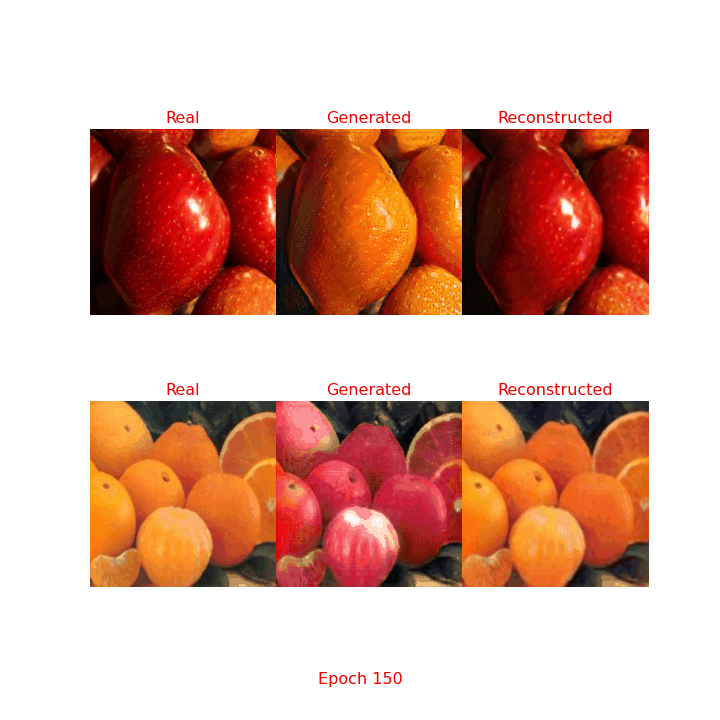

In [0]:
"""
GIF of Train Result Creation and Display.(From epoch 149 to 199)
"""
create_and_display_gif(gif_file_name='CycleGAN_Train_GIF.gif' , result_dir=cycleGAN_result_dir)

GIF File :  CycleGAN_Validation_GIF.gif  is created at  CycleGAN_Validation_Results/


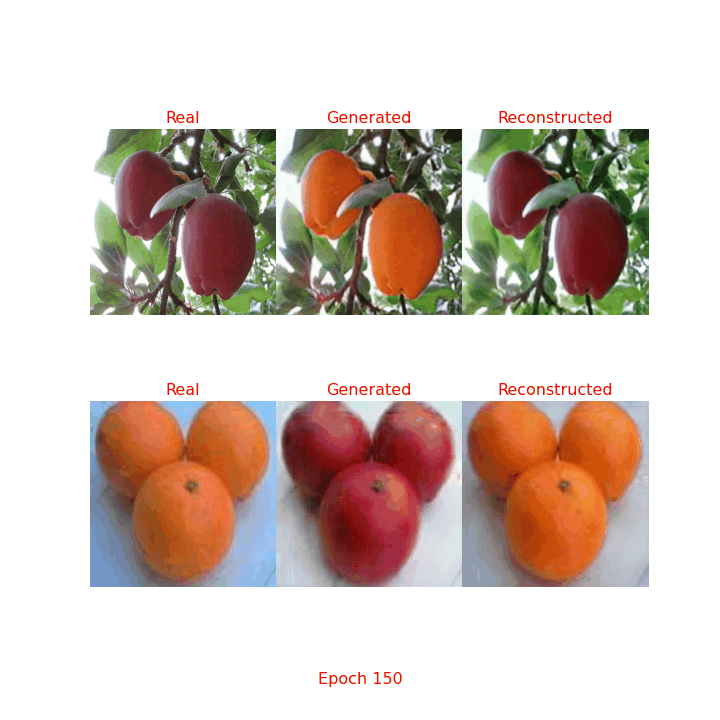

In [0]:
"""
GIF of Validation Result Creation and Display.(From epoch 149 to 199)
"""
create_and_display_gif(gif_file_name='CycleGAN_Validation_GIF.gif' , result_dir=cycleGAN_validation_result_dir)

**Plot Generators and Discriminators Losses and Cyclic Losses During CycleGAN Training**

* I have alreday saved the result dictionary contains various losses during trainig.I can easily load the saved dictioary using `torch.load` and create a pandas DataFrame to plot those values.

* As by regularization we are penalizing the generators to translate the image to target domain there are improvement in generators' result causing the decrease in cyclic loss as the training continues.

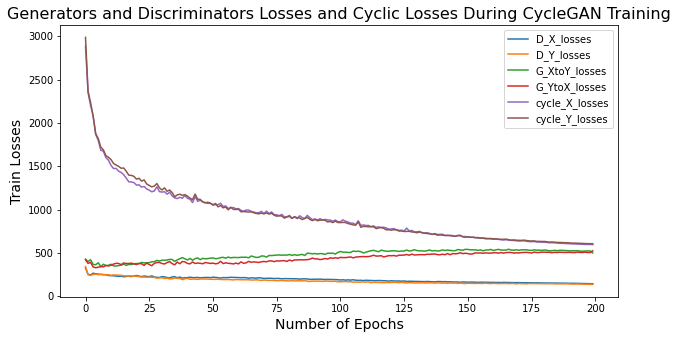

In [0]:
"""
CycleGAN Training Losses
"""

checkpoint_dict = torch.load(cycleGAN_checkpoint_dir + 'CycleGAN.pt')
loaded_results_df =  pd.DataFrame.from_dict(checkpoint_dict['results'])

plt.figure(figsize=(10,5))
plt.title("Generators and Discriminators Losses and Cyclic Losses During CycleGAN Training", fontsize=16)
plt.xlabel('Number of Epochs', fontsize=14)
plt.ylabel('Train Losses', fontsize=14)

for col in loaded_results_df.columns[2:]:
    plt.plot(loaded_results_df[col], label=col)

plt.legend()
plt.show()


##**Evaluation : Test Results**

In [0]:
"""
Create Generators Models of CycleGAN
""" 
G_XtoY, G_YtoX = create_cyclegan_model(n_gen_filter=ngf, n_dcrmnt_filter=ndf, n_residual_blocks=num_residual_blocks, 
                                       load_state=True)

Created Generators and move them to the correct compute resource (CPU or GPU)


In [0]:
"""
Load Generators
"""
G_XtoY.load_state_dict(checkpoint_dict['G_XtoY_state_dict'])

G_YtoX.load_state_dict(checkpoint_dict['G_YtoX_state_dict'])

G_XtoY = G_XtoY.eval()
G_YtoX = G_YtoX.eval()

Apple ----------------> Orange ----------------> Apple




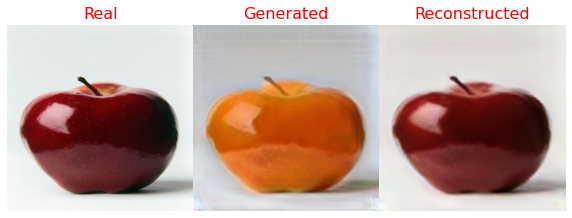

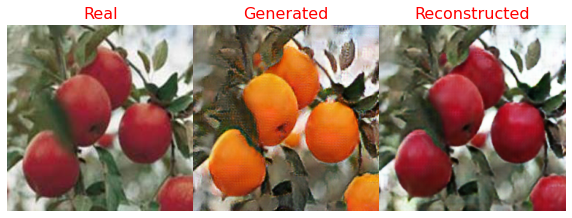

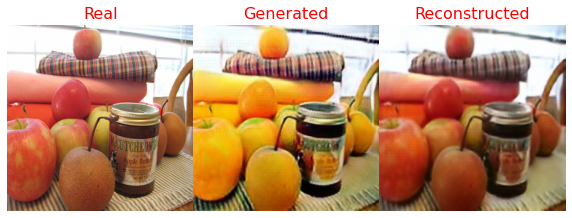

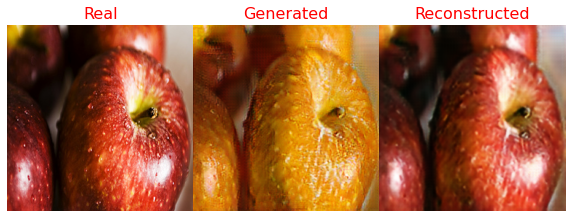

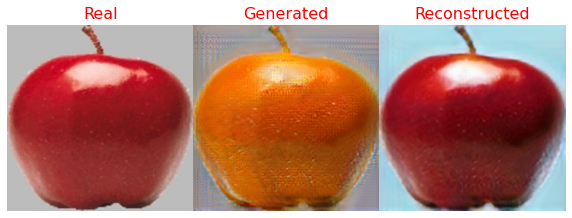

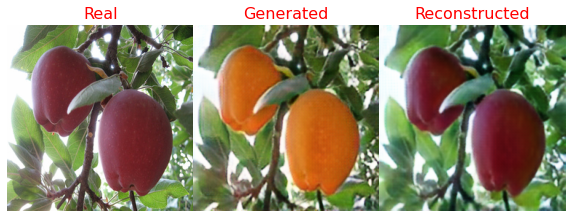

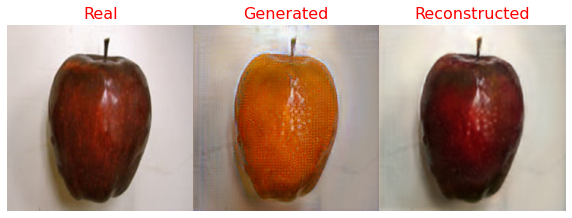


266 test images (X To Y To X) are generated.


Orange ----------------> Apple ----------------> Orange




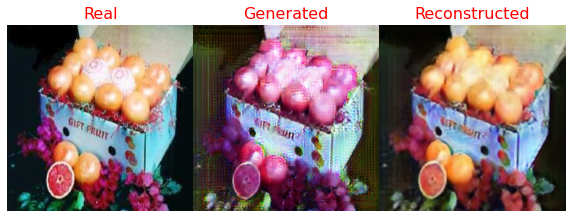

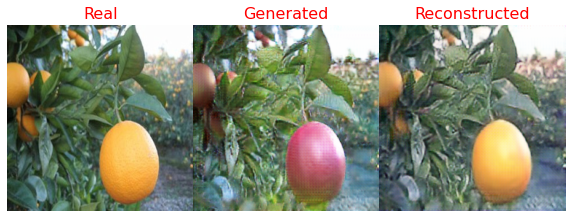

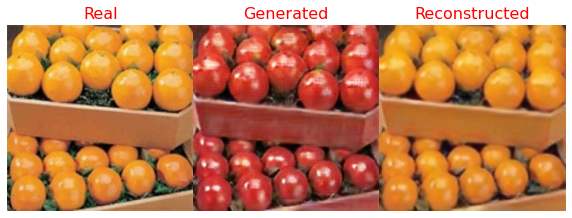

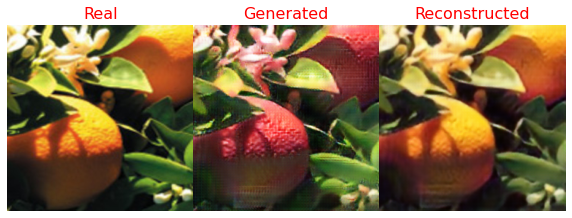

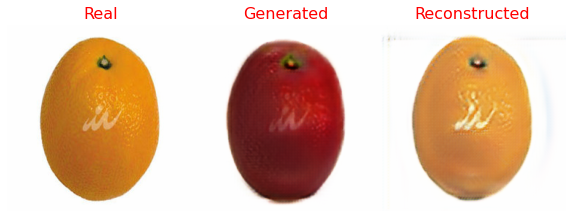

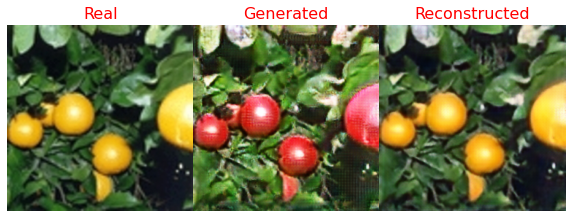


248 test images (Y To X To Y) are generated.


In [0]:
"""
Test Result Generation and Selective result show
"""

print('Apple ----------------> Orange ----------------> Apple\n\n')
for i, real_X in enumerate(tqdm(test_loader_X, desc="Test Batch X To Y To X", leave=False, disable=False)):
    """
    X To Y To X
    """
    fake_Y, reconstructed_X = real_gen_recon_image(G_XtoY, G_YtoX, real_X)
  
    """
    Generating result for all test data of domain X
    Showing only few results
    """
    show=False
    if i in [8,15,78,88,101,109,111]:
        show=True

    generate_result([real_X], [fake_Y], [reconstructed_X], i, result_dir=cycleGAN_test_resut_x2y2x_dir, is_test=True, show=show)

print('\n%d test images (X To Y To X) are generated.\n\n' % (i + 1))

print('Orange ----------------> Apple ----------------> Orange\n\n')
for i, real_Y in enumerate(tqdm(test_loader_Y, desc="Test Batch Y To X To Y", leave=False, disable=False)):
    """
    Y To X To Y
    """
    fake_X, reconstructed_Y = real_gen_recon_image(G_YtoX, G_XtoY, real_Y)

    """
    Generating result for all test data  of domain Y
    Showing only few results
    """
    show=False
    if i in [67,91,108,141,182,220]:
        show=True
        
    generate_result([real_Y], [fake_X], [reconstructed_Y], i, result_dir=cycleGAN_test_resut_y2x2y_dir, is_test=True, show=show)

print('\n%d test images (Y To X To Y) are generated.' % (i + 1))

**Some Observations**
* Overall, the creation of fake images and reconstruction of real images using CycleGAN shows plausible results.
  